In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

In [3]:
df = pd.read_excel("Online Retail.xlsx")

In [4]:
df.shape

(541909, 8)

In [5]:
df.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom


In [6]:
df = df[~df["StockCode"].str.contains('C', na=False)]
# dfdf["StockCode"].dropna(inplace=True)
# df = df[~df['StockCode'].str.contains('C')]
df = df[(df.Quantity>0) & (df.UnitPrice> 0)]
df.drop_duplicates(inplace=True)


In [7]:
print(df.isnull().sum())
df.dropna(inplace=True)

InvoiceNo           0
StockCode           0
Description         0
Quantity            0
InvoiceDate         0
UnitPrice           0
CustomerID     129925
Country             0
dtype: int64


In [8]:
import datetime
df["TotalAmount"] = df["UnitPrice"] * df["Quantity"]
first_date = df["InvoiceDate"].min()
last_date = df["InvoiceDate"].max()
today = last_date.to_pydatetime() + datetime.timedelta(days=1)

In [9]:
rfm_df = df.groupby(["CustomerID"]).agg({'InvoiceNo': lambda x: len(x),
                                'TotalAmount': lambda price: price.sum(),
                                'InvoiceDate': lambda date: (today - date.dt.to_pydatetime().max()).days})\
                                .reset_index().sort_values('InvoiceNo')

In [10]:
rfm_df.columns = ["CustomerID", "Frequency", "Monetary", "Recency"]

In [11]:
rfm_df.reset_index(inplace=True)

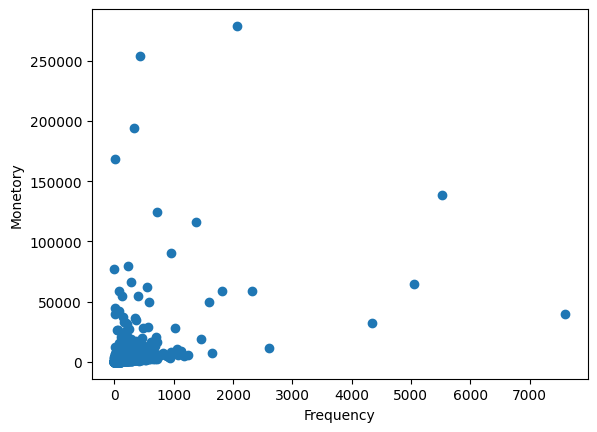

In [12]:
%matplotlib inline
plt.scatter(x=rfm_df["Frequency"], y=rfm_df["Monetary"])
plt.xlabel("Frequency")
plt.ylabel("Monetory")
plt.show()

In [13]:
rfm_df["R"] = pd.qcut(rfm_df["Recency"], 5, labels=[5, 4, 3, 2, 1])
rfm_df["M"] = pd.qcut(rfm_df["Monetary"], 5, labels=[1, 2, 3, 4, 5])
rfm_df["F"] = pd.qcut(rfm_df["Frequency"], 5, labels=[1, 2, 3, 4, 5])

In [14]:
rfm_df["RFM"] = rfm_df["R"].astype("str") + rfm_df["F"].astype("str") + rfm_df["M"].astype("str")

In [15]:
from sklearn.cluster import KMeans

df_cluster = rfm_df[["Recency", "Frequency", "Monetary"]]

kmeans = KMeans(n_clusters=3, random_state=42)
kmeans.fit(df_cluster)


df_cluster["Cluster"] = kmeans.fit_predict(df_cluster)

f:\Projects\.venv\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
f:\Projects\.venv\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\ASUS\AppData\Local\Temp\ipykernel_32688\1485110454.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_cluster["Cluster"] = kmeans.fit_predict(df_cluster)


In [16]:
df_cluster

,Recency,Frequency,Monetary,Cluster
0,326,1,77183.60,2
1,369,1,76.32,0
2,134,1,244.80,0
3,374,1,79.60,0
4,212,1,931.50,0
...,...,...,...,...
4328,1,2603,11718.65,0
4329,1,4345,32509.54,2
4330,4,5059,64824.04,2
4331,1,5529,138460.32,1


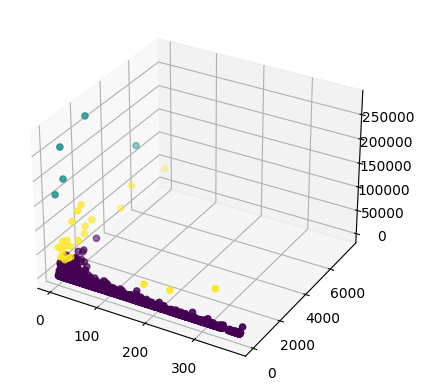

In [17]:
%matplotlib inline

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter3D(df_cluster["Recency"], df_cluster["Frequency"], df_cluster["Monetary"], c=df_cluster["Cluster"])
plt.show()


In [18]:
df_cluster.to_csv('rfm.csv')

In [19]:
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
ax = Axes3D(fig)


<Figure size 640x480 with 0 Axes>

In [20]:
# df_cluster.drop('ClusterName', axis=1, inplace=True)
empty_arr = np.zeros(shape=(df.shape[0]))
cluster_detail = pd.Series(empty_arr, name='ClusterName')
df_cluster = pd.concat([df_cluster, cluster_detail], axis=1)
for idx, row in df_cluster.iterrows():
    if row[-2] == 1:
        df_cluster.iloc[idx, -1] = 'legendary'
    elif row[-2] == 2:
        df_cluster.iloc[idx, -1] = 'potential loyalist'
    else:
        df_cluster.iloc[idx, -1] ='hibernate'


In [22]:
import plotly.express as px
from plotly.offline import init_notebook_mode, iplot
%matplotlib inline


# df_cluster["ClusterName"] = df_cluster.apply(lambda x["Cluster"]: legend_name(x))
init_notebook_mode(connected=True)  
# df = px.data.iris()
fig = px.scatter_3d(df_cluster, x='Recency', y='Frequency', z='Monetary',
              color='ClusterName')
fig.update_layout(showlegend=True)
fig.show()